In [1]:
import pandas as pd

# Filenames and corresponding questions
file_questions = {
    'ques_1.csv': '1. Does the jurisdiction have a drug overdose Good Samaritan Law?',
    'ques_2.csv': '2. What protection, if any, does the law provide from controlled substance possession laws?',
    'ques_3.csv': '3. What protection if any does the law provide from drug paraphernalia laws?',
    'ques_4.csv': '4. Does the law provide protection from probation or parole violations?',
    'ques_4.1.csv': '4.1. What protection does the law provide from probation or parole violations?',
    'ques_5.csv': '5. Is reporting an overdose considered a mitigating factor in sentencing?',
    'ques_5.1.csv': '5.1. For what types of crimes is mitigation permitted?'
}

# Initialize an empty DataFrame to store merged results
merged_df = pd.DataFrame()

for file_path, question in file_questions.items():
    # Read the CSV file
    print(file_path)
    df = pd.read_csv(file_path)
    
    # Assuming the first column is 'Jurisdiction' and the second column contains answers
    df.columns = ['Jurisdiction', question]
    
    # Set 'Jurisdiction' as the index
    df.set_index('Jurisdiction', inplace=True)
    
    # Merge with the main DataFrame
    if merged_df.empty:
        # For the first file, just initialize merged_df
        merged_df = df
    else:
        # For subsequent files, merge on 'Jurisdiction'
        merged_df = merged_df.merge(df, left_index=True, right_index=True, how='outer')

# Optionally, replace NaN values with empty strings or another placeholder
merged_df.fillna('', inplace=True)

# To save the combined DataFrame to a new CSV file
merged_df.to_csv('combined.csv')

ques_1.csv
ques_2.csv
ques_3.csv
ques_4.csv
ques_4.1.csv
ques_5.csv
ques_5.1.csv


/var/folders/33/778hxgqx3ml2s9w_zqrhkhdw0000gn/T/ipykernel_51473/444924519.py:37: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  merged_df.fillna('', inplace=True)


In [366]:
df=pd.read_csv('ques_1.csv')
df.iloc[:,1].unique()

array([' Yes ', 'No'], dtype=object)

In [368]:
df1=pd.read_csv('ques_1.csv')
df1.iloc[:,1].unique()

for column in df1.select_dtypes(include=['object']):
    df1[column] = df1[column].str.strip()
yes_no_mapping = {'Yes': 1, 'No': 0.01}
df1.iloc[:,1] = df1.iloc[:,1].map(yes_no_mapping)
df1

/var/folders/33/778hxgqx3ml2s9w_zqrhkhdw0000gn/T/ipykernel_67005/470176158.py:7: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df1.iloc[:,1] = df1.iloc[:,1].map(yes_no_mapping)


,Jurisdiction,1. Does the jurisdiction have a drug overdose Good Samaritan Law?
0,Alabama,1.00
1,Alaska,1.00
2,Arizona,1.00
3,Arkansas,1.00
4,California,1.00
5,Colorado,1.00
6,Connecticut,1.00
7,Delaware,1.00
8,District of Columbia,1.00
9,Florida,1.00


In [370]:
df1.to_excel("transformed1.xlsx")

In [372]:
import pandas as pd
# Define the mapping
df2=pd.read_csv('ques_2.csv')
df2.iloc[:,1].unique()
unique_values_mapping = {
    'Prosecution': 10,
    'Charge Prosecution': 11,
    'Arrest Charge Prosecution': 12,
    'Arrest Prosecution': 13,
    'Arrest Charge Prosecution Law provides other procedural protections': 14,
    'Law provides other procedural protections': 15,
    'Law provides an affirmative defense': 16
}

# Specify your actual columns here if you know which ones contain Yes/No answers
df2.iloc[:,1] = df2.iloc[:,1].map(unique_values_mapping)

print(df2)

            Jurisdiction  \
0                Alabama   
1                 Alaska   
2                Arizona   
3               Arkansas   
4             California   
5               Colorado   
6            Connecticut   
7               Delaware   
8   District of Columbia   
9                Florida   
10               Georgia   
11                Hawaii   
12                 Idaho   
13              Illinois   
14               Indiana   
15                  Iowa   
16              Kentucky   
17             Louisiana   
18                 Maine   
19              Maryland   
20         Massachusetts   
21              Michigan   
22             Minnesota   
23           Mississippi   
24              Missouri   
25               Montana   
26              Nebraska   
27                Nevada   
28         New Hampshire   
29            New Jersey   
30            New Mexico   
31              New York   
32        North Carolina   
33          North Dakota   
34                  

/var/folders/33/778hxgqx3ml2s9w_zqrhkhdw0000gn/T/ipykernel_67005/104854756.py:16: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df2.iloc[:,1] = df2.iloc[:,1].map(unique_values_mapping)


In [374]:
import pandas as pd

# Load the CSV file
file_path = 'ques_3.csv'  # Replace with the path to your CSV file
df3 = pd.read_csv(file_path)

# Strip trailing spaces from all string columns
for column in df3.select_dtypes(include=['object']):
    df3[column] = df3[column].str.strip()

# Save the cleaned DataFrame back to a CSV file
df3.iloc[:,1].unique() 

array(['Prosecution', 'None', 'Charge Prosecution',
       'Arrest Charge Prosecution', 'Arrest Prosecution',
       'Arrest Charge Prosecution Law provides other procedural protections',
       'Law provides other procedural protections',
       'Law provides an affirmative defense'], dtype=object)

In [376]:
# Existing mappings
value_mapping = {
    'Prosecution': 10,
    'Charge Prosecution': 11,
    'Arrest Charge Prosecution': 12,
    'Arrest Prosecution': 13,
    'Arrest Charge Prosecution Law provides other procedural protections': 14,
    'Law provides other procedural protections': 15,
    'Law provides an affirmative defense': 16
}

# New values list, which includes 'None' and potentially other new values
new_values = [
    'Prosecution', 'None', 'Charge Prosecution',
    'Arrest Charge Prosecution', 'Arrest Prosecution',
    'Arrest Charge Prosecution Law provides other procedural protections',
    'Law provides other procedural protections',
    'Law provides an affirmative defense'
]

# Determine the starting point for any new mappings
start_value = max(value_mapping.values()) + 1

# Add new values to the mapping, if they don't already exist
for value in new_values:
    if value not in value_mapping:
        value_mapping[value] = start_value
        start_value += 1

print("Updated mappings:", value_mapping)

Updated mappings: {'Prosecution': 10, 'Charge Prosecution': 11, 'Arrest Charge Prosecution': 12, 'Arrest Prosecution': 13, 'Arrest Charge Prosecution Law provides other procedural protections': 14, 'Law provides other procedural protections': 15, 'Law provides an affirmative defense': 16, 'None': 17}


In [378]:
#df=pd.read_csv('cleaned_file.csv')
df3.iloc[:,1].unique() #prosecution --> 15, charge --> 16, 
#arrest --> 17, charge_prosecution --> 1615, arrest_charge_prosectuion --> 171615
#arrest_prosection --> 1715 arrest_charge_prosectuion_lpopp --> 171615
#lpopp--> 18

array(['Prosecution', 'None', 'Charge Prosecution',
       'Arrest Charge Prosecution', 'Arrest Prosecution',
       'Arrest Charge Prosecution Law provides other procedural protections',
       'Law provides other procedural protections',
       'Law provides an affirmative defense'], dtype=object)

In [380]:
df3.iloc[:,1] = df3.iloc[:,1].map(value_mapping)

print(df3)

            Jurisdiction  \
0                Alabama   
1                 Alaska   
2                Arizona   
3               Arkansas   
4             California   
5               Colorado   
6            Connecticut   
7               Delaware   
8   District of Columbia   
9                Florida   
10               Georgia   
11                Hawaii   
12                 Idaho   
13              Illinois   
14               Indiana   
15                  Iowa   
16              Kentucky   
17             Louisiana   
18                 Maine   
19              Maryland   
20         Massachusetts   
21              Michigan   
22             Minnesota   
23           Mississippi   
24              Missouri   
25               Montana   
26              Nebraska   
27                Nevada   
28         New Hampshire   
29            New Jersey   
30            New Mexico   
31              New York   
32        North Carolina   
33          North Dakota   
34                  

/var/folders/33/778hxgqx3ml2s9w_zqrhkhdw0000gn/T/ipykernel_67005/45499454.py:1: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df3.iloc[:,1] = df3.iloc[:,1].map(value_mapping)


In [382]:
import pandas as pd

# Load the CSV file
file_path = 'ques_4.csv'  # Replace with the path to your CSV file
df4 = pd.read_csv(file_path)

# Strip trailing spaces from all string columns
for column in df4.select_dtypes(include=['object']):
    df4[column] = df4[column].str.strip()

# Save the cleaned DataFrame back to a CSV file
df4.iloc[:,1].unique()
for column in df4.select_dtypes(include=['object']):
    df4[column] = df4[column].str.strip()
yes_no_mapping = {'Yes': 1, 'No': 0.01}
df4.iloc[:,1] = df4.iloc[:,1].map(yes_no_mapping)
df4

/var/folders/33/778hxgqx3ml2s9w_zqrhkhdw0000gn/T/ipykernel_67005/3939273416.py:16: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df4.iloc[:,1] = df4.iloc[:,1].map(yes_no_mapping)


,Jurisdiction,4. Does the law provide protection from probation or parole violations?
0,Alabama,0.01
1,Alaska,0.01
2,Arizona,0.01
3,Arkansas,1.00
4,California,0.01
5,Colorado,0.01
6,Connecticut,0.01
7,Delaware,1.00
8,District of Columbia,1.00
9,Florida,1.00


In [390]:
import pandas as pd

# Load the CSV file
file_path = 'ques_4.1.csv'  # Replace with the path to your CSV file
df4_1 = pd.read_csv(file_path)
df4_1
# Strip trailing spaces from all string columns
for column in df4_1.select_dtypes(include=['object']):
    df4_1[column] = df4_1[column].str.strip()

# Save the cleaned DataFrame back to a CSV file
df4_1.iloc[:,1].unique()

,Jurisdiction,4.1. What protection does the law provide from probation or parole violations?
Arkansas,General protection from sanctions for viola...,NaN
Delaware,Protection from revocation of probation and...,NaN
District of Columbia,Protection from revocation of probation and...,NaN
Florida,General protection from sanctions for viola...,NaN
Georgia,General protection from sanctions for viola...,NaN
Hawaii,General protection from sanctions for viola...,NaN
Illinois,General protection from sanctions for viola...,NaN
Iowa,Protection from revocation of probation and...,NaN
Louisiana,General protection from sanctions for viola...,NaN
Maine,Protection from revocation of probation and...,NaN


In [386]:
# Initialize the mapping start value
start_value = 25

# New list of values to map, starting from 25
new_values = [
    'General protection from sanctions for violation of probation and/or parole',
    'Protection from revocation of probation and/or parole',
    'Protection from arrest  Protection from revocation of probation and/or parole',
    'Protection from arrest',
    'Protection from charge  Protection from prosecution'
]

# Initialize an empty mapping dictionary
value_mapping = {}

# Assign a unique number to each value, starting from 25
for value in new_values:
    if value not in value_mapping:
        value_mapping[value] = start_value
        start_value += 1

print("Mappings starting from 25:", value_mapping)

Mappings starting from 25: {'General protection from sanctions for violation of probation and/or parole': 25, 'Protection from revocation of probation and/or parole': 26, 'Protection from arrest  Protection from revocation of probation and/or parole': 27, 'Protection from arrest': 28, 'Protection from charge  Protection from prosecution': 29}


In [388]:
df4_1.iloc[:,1] = df4_1.iloc[:,1].map(value_mapping)

df4_1

,Jurisdiction,4.1. What protection does the law provide from probation or parole violations?
Arkansas,General protection from sanctions for violatio...,NaN
Delaware,Protection from revocation of probation and/or...,NaN
District of Columbia,Protection from revocation of probation and/or...,NaN
Florida,General protection from sanctions for violatio...,NaN
Georgia,General protection from sanctions for violatio...,NaN
Hawaii,General protection from sanctions for violatio...,NaN
Illinois,General protection from sanctions for violatio...,NaN
Iowa,Protection from revocation of probation and/or...,NaN
Louisiana,General protection from sanctions for violatio...,NaN
Maine,Protection from revocation of probation and/or...,NaN


In [333]:
import pandas as pd

# Load the CSV file
file_path = 'ques_5.csv'  # Replace with the path to your CSV file
df5 = pd.read_csv(file_path)

# Strip trailing spaces from all string columns
for column in df5.select_dtypes(include=['object']):
    df5[column] = df5[column].str.strip()

# Save the cleaned DataFrame back to a CSV file
df5.iloc[:,1].unique()
for column in df5.select_dtypes(include=['object']):
    df5[column] = df5[column].str.strip()
yes_no_mapping = {'Yes': 1, 'No': 0.01}
df5.iloc[:,1] = df5.iloc[:,1].map(yes_no_mapping)
df5

/var/folders/33/778hxgqx3ml2s9w_zqrhkhdw0000gn/T/ipykernel_67005/3466192065.py:16: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df5.iloc[:,1] = df5.iloc[:,1].map(yes_no_mapping)


,Jurisdiction,5. Is an overdose considered a mitigating factor in sentencing?
0,Alabama,0.01
1,Alaska,1.00
2,Arizona,1.00
3,Arkansas,0.01
4,California,0.01
5,Colorado,0.01
6,Connecticut,0.01
7,Delaware,0.01
8,District of Columbia,1.00
9,Florida,1.00


In [335]:
import pandas as pd

# Load the CSV file
file_path = 'ques_5.1.csv'  # Replace with the path to your CSV file
df5_1 = pd.read_csv(file_path)

# Strip trailing spaces from all string columns
for column in df5_1.select_dtypes(include=['object']):
    df5_1[column] = df5_1[column].str.strip()

# Save the cleaned DataFrame back to a CSV file
df5_1.iloc[:,1].unique()

array(['Controlled substances offenses',
       'Controlled substances offenses  Alcohol-related offenses',
       'Controlled substances offenses  Alcohol-related offenses  Other offenses beyond controlled substances and alcohol-related violations',
       'Other offenses beyond controlled substances and alcohol-related violations'],
      dtype=object)

In [337]:
# Initialize the starting point for the new mappings
start_value = 35

# List of new values to be mapped, starting from 35
new_values = [
    'Controlled substances offenses',
    'Controlled substances offenses  Alcohol-related offenses',
    'Controlled substances offenses  Alcohol-related offenses  Other offenses beyond controlled substances and alcohol-related violations',
    'Other offenses beyond controlled substances and alcohol-related violations'
]

# Initialize an empty mapping dictionary for these specific values
value_mapping = {}

# Loop through each value in the list, assigning a unique number starting from 35
for value in new_values:
    if value not in value_mapping:  # Check if the value is not already in the dictionary
        value_mapping[value] = start_value
        start_value += 1  # Increment the start value for the next unique entry

print("Mappings starting from 35:", value_mapping)

Mappings starting from 35: {'Controlled substances offenses': 35, 'Controlled substances offenses  Alcohol-related offenses': 36, 'Controlled substances offenses  Alcohol-related offenses  Other offenses beyond controlled substances and alcohol-related violations': 37, 'Other offenses beyond controlled substances and alcohol-related violations': 38}


In [339]:
df5_1.iloc[:,1] = df5_1.iloc[:,1].map(value_mapping)
df5_1

/var/folders/33/778hxgqx3ml2s9w_zqrhkhdw0000gn/T/ipykernel_67005/2675016953.py:1: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df5_1.iloc[:,1] = df5_1.iloc[:,1].map(value_mapping)


,Jurisdiction,5.1. For what types of crimes is mitigation permitted?
0,Alaska,35
1,Arizona,35
2,District of Columbia,36
3,Florida,37
4,Hawaii,36
5,Illinois,35
6,Indiana,35
7,Iowa,37
8,Louisiana,35
9,Maryland,37


In [395]:
combined_df = df1
data_frames = [df2, df3, df4, df5, df5_1]
for df in data_frames:
    combined_df = pd.merge(combined_df, df, on='Jurisdiction', how='outer')

In [403]:
combined_df.fillna(1e-10, inplace=True)

In [405]:
combined_df

,Jurisdiction,1. Does the jurisdiction have a drug overdose Good Samaritan Law?,"2. What protection, if any, does the law provide from controlled substance possession laws?",3. What protection if any does the law provide from drug paraphernalia laws?,4. Does the law provide protection from probation or parole violations?,5. Is an overdose considered a mitigating factor in sentencing?,5.1. For what types of crimes is mitigation permitted?
0,Alabama,1.00,1.000000e+01,1.000000e+01,1.000000e-02,1.000000e-02,1.000000e-10
1,Alaska,1.00,1.000000e+01,1.700000e+01,1.000000e-02,1.000000e+00,3.500000e+01
2,Arizona,1.00,1.100000e+01,1.100000e+01,1.000000e-02,1.000000e+00,3.500000e+01
3,Arkansas,1.00,1.200000e+01,1.700000e+01,1.000000e+00,1.000000e-02,1.000000e-10
4,California,1.00,1.200000e+01,1.200000e+01,1.000000e-02,1.000000e-02,1.000000e-10
5,Colorado,1.00,1.300000e+01,1.300000e+01,1.000000e-02,1.000000e-02,1.000000e-10
6,Connecticut,1.00,1.200000e+01,1.200000e+01,1.000000e-02,1.000000e-02,1.000000e-10
7,Delaware,1.00,1.200000e+01,1.200000e+01,1.000000e+00,1.000000e-02,1.000000e-10
8,District of Columbia,1.00,1.200000e+01,1.200000e+01,1.000000e+00,1.000000e+00,3.600000e+01
9,Florida,1.00,1.200000e+01,1.200000e+01,1.000000e+00,1.000000e+00,3.700000e+01


In [85]:
combined_df.to_csv('final_sample_data.csv')
combined_df.to_excel('final_sample_data_excel.xlsx')

In [407]:
# Set the 'Jurisdiction' column as the index of the DataFrame
copy_df=combined_df.set_index('Jurisdiction')

# Convert the DataFrame to a NumPy matrix, excluding the column headers
numpy_matrix = copy_df.to_numpy()
numpy_matrix

array([[1.0e+00, 1.0e+01, 1.0e+01, 1.0e-02, 1.0e-02, 1.0e-10],
       [1.0e+00, 1.0e+01, 1.7e+01, 1.0e-02, 1.0e+00, 3.5e+01],
       [1.0e+00, 1.1e+01, 1.1e+01, 1.0e-02, 1.0e+00, 3.5e+01],
       [1.0e+00, 1.2e+01, 1.7e+01, 1.0e+00, 1.0e-02, 1.0e-10],
       [1.0e+00, 1.2e+01, 1.2e+01, 1.0e-02, 1.0e-02, 1.0e-10],
       [1.0e+00, 1.3e+01, 1.3e+01, 1.0e-02, 1.0e-02, 1.0e-10],
       [1.0e+00, 1.2e+01, 1.2e+01, 1.0e-02, 1.0e-02, 1.0e-10],
       [1.0e+00, 1.2e+01, 1.2e+01, 1.0e+00, 1.0e-02, 1.0e-10],
       [1.0e+00, 1.2e+01, 1.2e+01, 1.0e+00, 1.0e+00, 3.6e+01],
       [1.0e+00, 1.2e+01, 1.2e+01, 1.0e+00, 1.0e+00, 3.7e+01],
       [1.0e+00, 1.2e+01, 1.2e+01, 1.0e+00, 1.0e-02, 1.0e-10],
       [1.0e+00, 1.2e+01, 1.2e+01, 1.0e+00, 1.0e+00, 3.6e+01],
       [1.0e+00, 1.1e+01, 1.1e+01, 1.0e-02, 1.0e-02, 1.0e-10],
       [1.0e+00, 1.4e+01, 1.4e+01, 1.0e+00, 1.0e+00, 3.5e+01],
       [1.0e+00, 1.3e+01, 1.3e+01, 1.0e-02, 1.0e+00, 3.5e+01],
       [1.0e+00, 1.5e+01, 1.5e+01, 1.0e+00, 1.0e+00, 3.

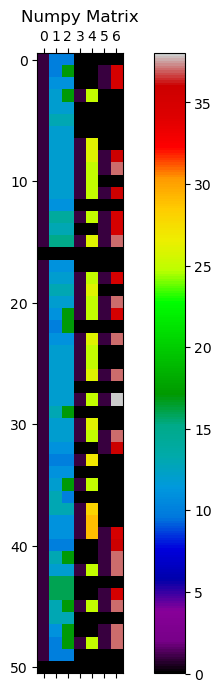

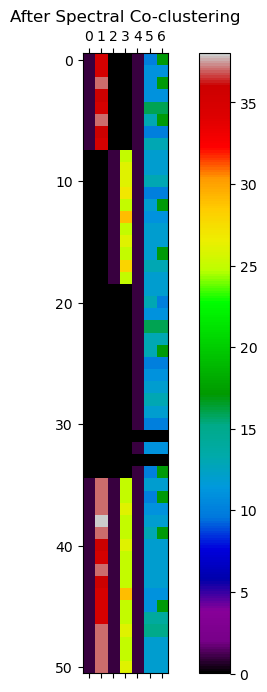

In [82]:
model = SpectralCoclustering(n_clusters=4, random_state=0)
model.fit(numpy_matrix)

# Rearrange the matrix according to the clustering result
fit_data = numpy_matrix[np.argsort(model.row_labels_)]
fit_data = fit_data[:, np.argsort(model.column_labels_)]

# Visualization helper function
def visualize_matrix(data, title):
    plt.figure(figsize=(8, 8))
    plt.matshow(data, fignum=1, cmap='nipy_spectral')
    plt.title(title)
    plt.colorbar()
    plt.show()


visualize_matrix(numpy_matrix, "Numpy Matrix")
visualize_matrix(fit_data, "After Spectral Co-clustering")

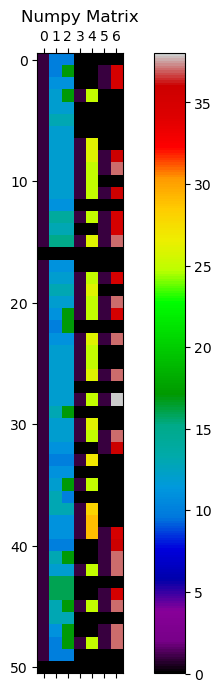

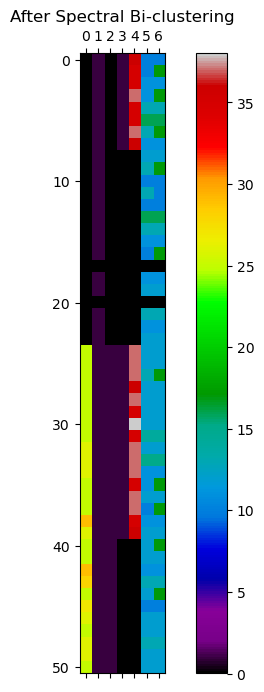

In [94]:
from sklearn.cluster import SpectralBiclustering
model = SpectralBiclustering(n_clusters=4, method="log", random_state=0)
model.fit(numpy_matrix)
fit_data = numpy_matrix[np.argsort(model.row_labels_)]
fit_data = fit_data[:, np.argsort(model.column_labels_)]

# Visualization helper function
def visualize_matrix(data, title):
    plt.figure(figsize=(8, 8))
    plt.matshow(data, fignum=1, cmap='nipy_spectral')
    plt.title(title)
    plt.colorbar()
    plt.show()


visualize_matrix(numpy_matrix, "Numpy Matrix")
visualize_matrix(fit_data, "After Spectral Bi-clustering")

In [24]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer

# Paths to your files
file_paths = [
    'ques_3.csv'
]

# Initialize TF-IDF Vectorizer
tfidf_vectorizer = TfidfVectorizer()

for file_path in file_paths:
    # Read the file
    df = pd.read_csv(file_path)
    
    # Assuming the answers are in the second column
    answers = df.iloc[:, 1].astype(str)  # Ensure text data, fill NaNs with empty strings
    
    # Fit and transform the answers to a TF-IDF matrix
    tfidf_matrix = tfidf_vectorizer.fit_transform(answers)
    print(tfidf_matrix)
    
    # Output the shape of the TF-IDF matrix

print(f"Processed {file_path}: TF-IDF matrix shape {tfidf_matrix.shape}")

  (0, 9)	1.0
  (1, 6)	1.0
  (2, 3)	0.7789475666484499
  (2, 9)	0.6270890593946434
  (3, 6)	1.0
  (4, 2)	0.6412623156684658
  (4, 3)	0.5977033970458319
  (4, 9)	0.48117906403270444
  (5, 2)	0.7998608807261326
  (5, 9)	0.6001854475776761
  (6, 2)	0.6412623156684658
  (6, 3)	0.5977033970458319
  (6, 9)	0.48117906403270444
  (7, 2)	0.6412623156684658
  (7, 3)	0.5977033970458319
  (7, 9)	0.48117906403270444
  (8, 2)	0.6412623156684658
  (8, 3)	0.5977033970458319
  (8, 9)	0.48117906403270444
  (9, 2)	0.6412623156684658
  (9, 3)	0.5977033970458319
  (9, 9)	0.48117906403270444
  (10, 2)	0.6412623156684658
  (10, 3)	0.5977033970458319
  (10, 9)	0.48117906403270444
  :	:
  (37, 3)	0.7789475666484499
  (37, 9)	0.6270890593946434
  (38, 3)	0.7789475666484499
  (38, 9)	0.6270890593946434
  (39, 9)	1.0
  (40, 6)	1.0
  (41, 2)	0.6412623156684658
  (41, 3)	0.5977033970458319
  (41, 9)	0.48117906403270444
  (42, 4)	0.47140097427896593
  (42, 0)	0.47140097427896593
  (42, 1)	0.47140097427896593
  (42, 1

In [25]:
df=pd.read_csv('combined.csv')
nan_sum = df.isnull().sum().sum()

In [26]:
print(nan_sum)

59


In [30]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import SpectralCoclustering
from sklearn.datasets import make_biclusters
from sklearn.metrics import consensus_score

# Load the data, assuming the first column is the index
df = pd.read_csv('combined.csv', index_col=0)

# Combine all text data into a single column, ignoring NaNs
# This step depends on your specific data structure; you may need to adjust
text_data = df.fillna('').astype(str).apply(lambda x: ' '.join(x), axis=1)

# Generate TF-IDF matrix
tfidf_vectorizer = TfidfVectorizer()
tfidf_matrix = tfidf_vectorizer.fit_transform(text_data)

model = SpectralCoclustering(n_clusters=4, random_state=0)
model.fit(tfidf_matrix)

# Rearrange the matrix according to the clustering result
fit_data = tfidf_matrix[np.argsort(model.row_labels_)]
fit_data = fit_data[:, np.argsort(model.column_labels_)]

print(fit_data)
# def visualize_matrix(data, title):
#     plt.figure(figsize=(8, 8))
#     plt.matshow(data, fignum=1, cmap='nipy_spectral')
#     plt.title(title)
#     plt.colorbar()
#     plt.show()

# # Visualize the original matrix, shuffled matrix, and clustered matrix
# visualize_matrix(tfidf_matrix, "TF_IDF Matrix")
# visualize_matrix(fit_data, "After Spectral Co-clustering")

  (0, 0)	0.7469247405346127
  (0, 27)	0.6013168316819275
  (0, 32)	0.28376310527147464
  (1, 31)	0.6380241248304646
  (1, 0)	0.5751442803118654
  (1, 27)	0.46302380632026574
  (1, 32)	0.21850223737883992
  (2, 31)	0.3827457335408783
  (2, 0)	0.690049203134127
  (2, 27)	0.5555287942882429
  (2, 32)	0.2621556015553786
  (3, 29)	0.6380241248304646
  (3, 0)	0.5751442803118654
  (3, 27)	0.46302380632026574
  (3, 32)	0.21850223737883992
  (4, 31)	0.35183633773751916
  (4, 0)	0.6343229021610365
  (4, 25)	0.5920955077706059
  (4, 27)	0.2553329787401012
  (4, 32)	0.24098470259961666
  (5, 31)	0.5378714719172731
  (5, 29)	0.5378714719172731
  (5, 0)	0.4848620742959289
  (5, 27)	0.3903415036295006
  (5, 32)	0.18420325417538563
  :	:
  (48, 7)	0.32030505219563915
  (48, 32)	0.38429209635820405
  (49, 29)	0.5610643428632279
  (49, 20)	0.32030505219563915
  (49, 0)	0.25288459724815787
  (49, 16)	0.32030505219563915
  (49, 27)	0.4071729226416645
  (49, 7)	0.32030505219563915
  (49, 32)	0.384292096358

In [56]:
combined_df.head()

,Jurisdiction,1. Does the jurisdiction have a drug overdose Good Samaritan Law?,"2. What protection, if any, does the law provide from controlled substance possession laws?",3. What protection if any does the law provide from drug paraphernalia laws?,4. Does the law provide protection from probation or parole violations?,5.1. For what types of crimes is mitigation permitted?_x,5. Is an overdose considered a mitigating factor in sentencing?,5.1. For what types of crimes is mitigation permitted?_y
0,Alabama,1.0,10.0,10.0,0.01,1.000000e-10,0.01,1.000000e-10
1,Alaska,1.0,10.0,17.0,0.01,1.000000e-10,1.00,3.500000e+01
2,Arizona,1.0,11.0,11.0,0.01,1.000000e-10,1.00,3.500000e+01
3,Arkansas,1.0,12.0,17.0,1.00,1.000000e-10,0.01,1.000000e-10
4,California,1.0,12.0,12.0,0.01,1.000000e-10,0.01,1.000000e-10


In [515]:
from sklearn.cluster import SpectralCoclustering
import pandas as pd

df = pd.DataFrame(combined_df)

# Transpose the DataFrame
transposed_df = df.set_index('Jurisdiction').T

# Load the states.csv file into a DataFrame
states_df = pd.read_csv('states.csv')

# Create a dictionary mapping state names to abbreviations
state_to_abbr = dict(zip(states_df['State'], states_df['Abbreviation']))

# Map state names to abbreviations in transposed_df
transposed_df.columns = transposed_df.columns.map(state_to_abbr.get)

# Perform Spectral Co-clustering
model = SpectralCoclustering(n_clusters=3, random_state=0)
model.fit(transposed_df)

# Reorder the rows and columns of the DataFrame according to the co-clustering
fit_data = transposed_df.iloc[np.argsort(model.row_labels_)]
fit_data = fit_data.iloc[:, np.argsort(model.column_labels_)]

# Visualization helper function
def visualize_matrix(data, title, row_labels=None, col_labels=None):
    plt.figure(figsize=(250, 50))
    plt.matshow(data, fignum=1, cmap='nipy_spectral', aspect='auto')
    plt.title(title)
    plt.colorbar()
    # Show row and column labels
    if row_labels is not None:
        plt.gca().set_xticks(np.arange(len(col_labels)))
        plt.gca().set_xticklabels([''] + col_labels, fontsize=100)
        plt.gca().set_yticks(np.arange(len(row_labels)))
        plt.gca().set_yticklabels([''] + row_labels, fontsize=100)
    plt.show()
    
# Visualize the original matrix with row and column labels
visualize_matrix(transposed_df, "Original Matrix", 
                 row_labels=transposed_df.index, col_labels=transposed_df.columns)

# Visualize the clustered matrix with row and column labels
visualize_matrix(fit_data, "Co-clustered Matrix", 
                 row_labels=fit_data.index[np.argsort(model.row_labels_)], 
                 col_labels=fit_data.columns[np.argsort(model.column_labels_)])

In [513]:
from sklearn.cluster import SpectralBiclustering

df = pd.DataFrame(combined_df)

# Transpose the DataFrame
transposed_df = df.set_index('Jurisdiction').T

# Load the states.csv file into a DataFrame
states_df = pd.read_csv('states.csv')

# Create a dictionary mapping state names to abbreviations
state_to_abbr = dict(zip(states_df['State'], states_df['Abbreviation']))

# Map state names to abbreviations in transposed_df
transposed_df.columns = transposed_df.columns.map(state_to_abbr.get)

model = SpectralBiclustering(n_clusters=3, method='log', random_state=0)
model.fit(transposed_df)

# Reorder the rows and columns of the DataFrame according to the bi-clustering
fit_data = transposed_df.iloc[np.argsort(model.row_labels_)]
fit_data = fit_data.iloc[:, np.argsort(model.column_labels_)]

# Visualization helper function
def visualize_matrix(data, title, row_labels=None, col_labels=None):
    plt.figure(figsize=(250, 50))
    plt.matshow(data, fignum=1, cmap='nipy_spectral', aspect='auto')
    plt.title(title)
    plt.colorbar()
    # Show row and column labels
    if row_labels is not None:
        plt.gca().set_xticks(np.arange(len(col_labels)))
        plt.gca().set_xticklabels([''] + col_labels, fontsize=100)
        plt.gca().set_yticks(np.arange(len(row_labels)))
        plt.gca().set_yticklabels([''] + row_labels, fontsize=100)
    plt.show()

# Visualize the original matrix with row and column labels
visualize_matrix(transposed_df, "Original Matrix", 
                 row_labels=transposed_df.index, col_labels=transposed_df.columns)

# Visualize the clustered matrix with row and column labels
visualize_matrix(fit_data, "Bi-clustered Matrix", 
                 row_labels=fit_data.index[np.argsort(model.row_labels_)], 
                 col_labels=fit_data.columns[np.argsort(model.column_labels_)])

In [143]:
combined_df_transposed = combined_df.transpose()
combined_df_transposed = combined_df_transposed.reset_index()
combined_df_transposed = combined_df_transposed.set_index(combined_df_transposed.columns[0])
combined_df_transposed.columns = combined_df_transposed.iloc[0]
combined_df_transposed = combined_df_transposed[1:]
combined_df_transposed.head()

Jurisdiction,Alabama,Alaska,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,District of Columbia,Florida,...,South Dakota,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Wyoming
index,,,,,,,,,,,,,,,,,,,,,
1. Does the jurisdiction have a drug overdose Good Samaritan Law?,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.01
"2. What protection, if any, does the law provide from controlled substance possession laws?",10.0,10.0,11.0,12.0,12.0,13.0,12.0,12.0,12.0,12.0,...,13.0,12.0,16.0,16.0,13.0,13.0,11.0,10.0,10.0,0.0
3. What protection if any does the law provide from drug paraphernalia laws?,10.0,17.0,11.0,17.0,12.0,13.0,12.0,12.0,12.0,12.0,...,17.0,12.0,16.0,16.0,17.0,13.0,17.0,17.0,10.0,0.0
4. Does the law provide protection from probation or parole violations?,0.01,0.01,0.01,1.0,0.01,0.01,0.01,1.0,1.0,1.0,...,0.01,1.0,0.01,0.01,1.0,0.01,0.01,1.0,0.01,0.0
5.1. For what types of crimes is mitigation permitted?_x,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [145]:
combined_df_transposed.columns[0]

'Alabama'

In [19]:
original_df = pd.read_excel('Good Samaritan Overdose Prevention Laws Data 8.25.2023.xlsx')
original_df.head()

,Jurisdictions,Effective Date,Valid Through Date,goodsam-law,goodsam-cs_Arrest,goodsam-cs_Charge,goodsam-cs_Prosecution,goodsam-cs_Law provides an affirmative defense,goodsam-cs_Law provides other procedural protections,goodsam-cs_None,...,goodsam-paroleyn,goodsam-parole_Protection from arrest,goodsam-parole_Protection from charge,goodsam-parole_Protection from prosecution,goodsam-parole_Protection from revocation of probation and/or parole,goodsam-parole_General protection from sanctions for violation of probation and/or parole,goodsam-mitigation,goodsam-mit-type_Controlled substances offenses,goodsam-mit-type_Alcohol-related offenses,goodsam-mit-type_Other offenses beyond controlled substances and alcohol-related violations
0,Alabama,2007-01-01,2009-05-19,0,.,.,.,.,.,.,...,.,.,.,.,.,.,.,.,.,.
1,Alabama,2009-05-19,2012-04-22,0,.,.,.,.,.,.,...,.,.,.,.,.,.,.,.,.,.
2,Alabama,2012-04-23,2015-06-09,0,.,.,.,.,.,.,...,.,.,.,.,.,.,.,.,.,.
3,Alabama,2015-06-10,2022-05-31,1,0,0,1,0,0,0,...,1,.,.,.,.,.,0,.,.,.
4,Alabama,2022-06-01,2023-01-01,1,0,0,1,0,0,0,...,1,.,.,.,.,.,0,.,.,.


In [21]:
original_df.replace(0, 0.0001, inplace=True)
original_df = original_df.fillna(0.0001)
original_df.replace('.', 0.0001, inplace=True)
original_df = original_df.drop(columns=['Effective Date', 'Valid Through Date'])
# original_df = original_df.groupby('Jurisdictions', as_index=False).sum()
original_df.head()

,Jurisdictions,goodsam-law,goodsam-cs_Arrest,goodsam-cs_Charge,goodsam-cs_Prosecution,goodsam-cs_Law provides an affirmative defense,goodsam-cs_Law provides other procedural protections,goodsam-cs_None,goodsam-paraphernalia_Arrest,goodsam-paraphernalia_Charge,...,goodsam-paroleyn,goodsam-parole_Protection from arrest,goodsam-parole_Protection from charge,goodsam-parole_Protection from prosecution,goodsam-parole_Protection from revocation of probation and/or parole,goodsam-parole_General protection from sanctions for violation of probation and/or parole,goodsam-mitigation,goodsam-mit-type_Controlled substances offenses,goodsam-mit-type_Alcohol-related offenses,goodsam-mit-type_Other offenses beyond controlled substances and alcohol-related violations
0,Alabama,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,...,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001
1,Alabama,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,...,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001
2,Alabama,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,...,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001
3,Alabama,1.0000,0.0001,0.0001,1.0000,0.0001,0.0001,0.0001,0.0001,0.0001,...,1.0000,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001
4,Alabama,1.0000,0.0001,0.0001,1.0000,0.0001,0.0001,0.0001,0.0001,0.0001,...,1.0000,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001


In [29]:
from sklearn.cluster import SpectralBiclustering
from sklearn.cluster import SpectralCoclustering
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# Transpose the DataFrame
og_transposed_df = original_df.set_index('Jurisdictions').T

# Load the states.csv file into a DataFrame
states_df = pd.read_csv('states.csv')

# Create a dictionary mapping state names to abbreviations
state_to_abbr = dict(zip(states_df['State'], states_df['Abbreviation']))

# Map state names to abbreviations in transposed_df
og_transposed_df.columns = og_transposed_df.columns.map(state_to_abbr.get)

# Perform Spectral Co-clustering
model = SpectralCoclustering(n_clusters=4, random_state=0)
model.fit(og_transposed_df)

# Reorder the rows and columns of the DataFrame according to the co-clustering
fit_data = og_transposed_df.iloc[np.argsort(model.row_labels_)]
fit_data = fit_data.iloc[:, np.argsort(model.column_labels_)]

# Visualization helper function
def visualize_matrix(data, title, row_labels=None, col_labels=None):
    plt.figure(figsize=(250, 50))
    plt.matshow(data, fignum=1, cmap='nipy_spectral', aspect='auto')
    plt.title(title)
    plt.colorbar()
    # Show row and column labels
    if row_labels is not None:
        plt.gca().set_xticks(np.arange(len(col_labels)))
        plt.gca().set_xticklabels([''] + col_labels, fontsize=100)
        plt.gca().set_yticks(np.arange(len(row_labels)))
        plt.gca().set_yticklabels([''] + row_labels, fontsize=100)
    plt.show()
    
# Visualize the original matrix with row and column labels
visualize_matrix(og_transposed_df, "Original Matrix", 
                 row_labels=og_transposed_df.index, col_labels=og_transposed_df.columns)

# Visualize the clustered matrix with row and column labels
visualize_matrix(fit_data, "Co-clustered Matrix", 
                 row_labels=fit_data.index[np.argsort(model.row_labels_)], 
                 col_labels=fit_data.columns[np.argsort(model.column_labels_)])

In [523]:
# Transpose the DataFrame
og_transposed_df = original_df.set_index('Jurisdictions').T

# Load the states.csv file into a DataFrame
states_df = pd.read_csv('states.csv')

# Create a dictionary mapping state names to abbreviations
state_to_abbr = dict(zip(states_df['State'], states_df['Abbreviation']))

# Map state names to abbreviations in transposed_df
og_transposed_df.columns = og_transposed_df.columns.map(state_to_abbr.get)

model = SpectralBiclustering(n_clusters=4, method='log', random_state=0)
model.fit(og_transposed_df)

# Reorder the rows and columns of the DataFrame according to the bi-clustering
fit_data = og_transposed_df.iloc[np.argsort(model.row_labels_)]
fit_data = fit_data.iloc[:, np.argsort(model.column_labels_)]

# Visualization helper function
def visualize_matrix(data, title, row_labels=None, col_labels=None):
    plt.figure(figsize=(250, 50))
    plt.matshow(data, fignum=1, cmap='nipy_spectral', aspect='auto')
    plt.title(title)
    plt.colorbar()
    # Show row and column labels
    if row_labels is not None:
        plt.gca().set_xticks(np.arange(len(col_labels)))
        plt.gca().set_xticklabels([''] + col_labels, fontsize=100)
        plt.gca().set_yticks(np.arange(len(row_labels)))
        plt.gca().set_yticklabels([''] + row_labels, fontsize=100)
    plt.show()
    
# Visualize the original matrix with row and column labels
visualize_matrix(og_transposed_df, "Original Matrix", 
                 row_labels=og_transposed_df.index, col_labels=og_transposed_df.columns)

# Visualize the clustered matrix with row and column labels
visualize_matrix(fit_data, "Bi-clustered Matrix", 
                 row_labels=fit_data.index[np.argsort(model.row_labels_)], 
                 col_labels=fit_data.columns[np.argsort(model.column_labels_)])

In [53]:
import pandas as pd

original_df1 = pd.read_excel('Good Samaritan Overdose Prevention Laws Data 8.25.2023.xlsx')

original_df1.replace(0, 100, inplace=True)
original_df1 = original_df1.fillna(100)
original_df1.replace('.', 100, inplace=True)
original_df1 = original_df1.groupby('Jurisdictions', as_index=False).last()
original_df1 = original_df1.drop(columns=['Effective Date', 'Valid Through Date'])
print(original_df1.dtypes)
original_df1.head()

Jurisdictions                                                                                  object
goodsam-law                                                                                     int64
goodsam-cs_Arrest                                                                               int64
goodsam-cs_Charge                                                                               int64
goodsam-cs_Prosecution                                                                          int64
goodsam-cs_Law provides an affirmative defense                                                  int64
goodsam-cs_Law provides other procedural protections                                            int64
goodsam-cs_None                                                                                 int64
goodsam-paraphernalia_Arrest                                                                    int64
goodsam-paraphernalia_Charge                                                      

,Jurisdictions,goodsam-law,goodsam-cs_Arrest,goodsam-cs_Charge,goodsam-cs_Prosecution,goodsam-cs_Law provides an affirmative defense,goodsam-cs_Law provides other procedural protections,goodsam-cs_None,goodsam-paraphernalia_Arrest,goodsam-paraphernalia_Charge,...,goodsam-paroleyn,goodsam-parole_Protection from arrest,goodsam-parole_Protection from charge,goodsam-parole_Protection from prosecution,goodsam-parole_Protection from revocation of probation and/or parole,goodsam-parole_General protection from sanctions for violation of probation and/or parole,goodsam-mitigation,goodsam-mit-type_Controlled substances offenses,goodsam-mit-type_Alcohol-related offenses,goodsam-mit-type_Other offenses beyond controlled substances and alcohol-related violations
0,Alabama,1,100,100,1,100,100,100,100,100,...,1,100,100,100,100,100,100,100,100,100
1,Alaska,1,100,100,1,100,100,100,100,100,...,1,100,100,100,100,100,1,1,100,100
2,Arizona,1,100,1,1,100,100,100,100,1,...,1,100,100,100,100,100,1,1,100,100
3,Arkansas,1,1,1,1,100,100,100,100,100,...,100,100,100,100,100,1,100,100,100,100
4,California,1,1,1,1,100,100,100,1,1,...,1,100,100,100,100,100,100,100,100,100


In [55]:
# SpectralCoclustering

from sklearn.cluster import SpectralCoclustering
from matplotlib import colormaps
import numpy as np
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
import matplotlib.colors as mcolors

og_transposed_df = original_df1.set_index('Jurisdictions').T

# og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df)//2, :len(og_transposed_df.columns)//2]
og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df)//2, :len(og_transposed_df.columns)//2]
og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df.columns)//2]

states_df = pd.read_csv('states.csv')

state_to_abbr = dict(zip(states_df['State'], states_df['Abbreviation']))

og_transposed_df.columns = og_transposed_df.columns.map(state_to_abbr.get)

# Perform Spectral Co-clustering
model = SpectralCoclustering(n_clusters=5, random_state=0)
model.fit(og_transposed_df)

fit_data = og_transposed_df.iloc[np.argsort(model.row_labels_)]
fit_data = fit_data.iloc[:, np.argsort(model.column_labels_)]

sorted_row_indices = np.argsort(model.row_labels_)  # model.row labels [2 0 2 2 2 1 2 0 0 0 2]
sorted_col_indices = np.argsort(model.column_labels_)

def getSorted(type, originaldf, modelLabels, sortedIndices):
    arr=[]
    if type == "row":
        for label in np.unique(modelLabels):
            rows_in_group = [originaldf.index[entry] for entry in sortedIndices if modelLabels[entry] == label]
            arr.extend(rows_in_group)
    else:
        for label in np.unique(modelLabels):
            rows_in_group = [originaldf.columns[entry] for entry in sortedIndices if modelLabels[entry] == label]
            arr.extend(rows_in_group)      
    return arr
    
def visualize_matrix(data, title, row_labels=None, col_labels=None, sorted=None):

    unique_values = np.unique(data)
    colors = plt.cm.viridis(np.linspace(0, 1, len(unique_values)))
    cmap = mcolors.ListedColormap(colors)
    
    plt.figure(figsize=(250, 50))
    plt.matshow(data, fignum=1, cmap=cmap, aspect='auto')
    plt.title(title, fontsize=150, y=1.1)
    cbar = plt.colorbar(ticks=unique_values)
    cbar.set_ticklabels(unique_values)
        
    if row_labels is not None:
        if sorted == True:
            # sorted_row_labels = row_labels[np.argsort(model.row_labels_)]
            # sorted_col_labels = col_labels[np.argsort(model.column_labels_)]
            sorted_row_labels = pd.Index(getSorted("row", og_transposed_df, model.row_labels_, sorted_row_indices))
            sorted_col_labels = pd.Index(getSorted("column", og_transposed_df, model.column_labels_, sorted_col_indices))

            plt.gca().set_xticks(np.arange(len(sorted_col_labels)))
            plt.gca().set_xticklabels([''] + sorted_col_labels, fontsize=100)
            plt.gca().set_yticks(np.arange(len(sorted_row_labels)))
            plt.gca().set_yticklabels([''] + sorted_row_labels, fontsize=100)
        else:
            plt.gca().set_xticks(np.arange(len(col_labels)))
            plt.gca().set_xticklabels([''] + col_labels, fontsize=100)
            plt.gca().set_yticks(np.arange(len(row_labels)))
            plt.gca().set_yticklabels([''] + row_labels, fontsize=100)
            
    plt.show()
    
visualize_matrix(og_transposed_df, "Original Matrix", 
                 row_labels=og_transposed_df.index, col_labels=og_transposed_df.columns)

visualize_matrix(fit_data, "Co-clustered Matrix", 
                 row_labels=fit_data.index, 
                 col_labels=fit_data.columns,
                 sorted=True)

# print(sorted_row_indices)   # [ 1  7  8  9  5  0  2  3  4  6 10]
# print(og_transposed_df.index)
# print(sorted_col_indices)
# print(og_transposed_df.columns)

# print("New Row",getSorted("row",og_transposed_df,model.row_labels_,sorted_row_indices))
# print("New Col",getSorted("column",og_transposed_df,model.column_labels_,sorted_col_indices))

for label in np.unique(model.row_labels_):
    rows_in_group = [og_transposed_df.index[entry] for entry in sorted_row_indices if model.row_labels_[entry] == label]
    #rows_in_group = og_transposed_df.index[sorted_row_indices[model.row_labels_ == label]]
    print(f"Rows in Group {label}: {', '.join(rows_in_group)}")

for label in np.unique(model.column_labels_):
    columns_in_group = [og_transposed_df.columns[entry] for entry in sorted_col_indices if model.column_labels_[entry] == label]
    # columns_in_group = og_transposed_df.columns[sorted_col_indices[model.column_labels_ == label]]
    print(f"Columns in Group {label}: {', '.join(columns_in_group)}")

def calculate_msr(data, model):
    row_labels = model.row_labels_
    col_labels = model.column_labels_

    sum_squared_residue = 0

    for i in np.unique(row_labels):
        for j in np.unique(col_labels):
            submatrix = data[np.ix_(row_labels == i, col_labels == j)]
            mean = np.mean(submatrix)
            squared_residue = np.sum((submatrix - mean) ** 2)
            sum_squared_residue += squared_residue

    msr = sum_squared_residue / (data.shape[0] * data.shape[1])

    return msr

msr = calculate_msr(og_transposed_df.values, model)
print(f"Mean Squared Residue (MSR): {msr}")

Rows in Group 0: goodsam-cs_Law provides an affirmative defense, goodsam-cs_Law provides other procedural protections, goodsam-cs_None, goodsam-paraphernalia_Law provides an affirmative defense
Rows in Group 1: goodsam-law, goodsam-cs_Prosecution
Rows in Group 2: goodsam-cs_Arrest, goodsam-paraphernalia_Arrest
Rows in Group 3: goodsam-cs_Charge, goodsam-paraphernalia_Charge
Rows in Group 4: goodsam-paraphernalia_Prosecution
Columns in Group 0: MS, MD, LA, CA, CT, DE, DC, FL, GA, HI, IL
Columns in Group 1: KS
Columns in Group 2: KY, ID, AZ, MN
Columns in Group 3: IN, CO, ME
Columns in Group 4: IA, AR, AK, MA, MI, AL
Mean Squared Residue (MSR): 223.425


In [57]:
# Spectral Coclustering with colored clusters

clustered_df = og_transposed_df.copy()
print(model.row_labels_)
print(model.column_labels_)

for i in range(og_transposed_df.shape[0]):
    for j in range(og_transposed_df.shape[1]):
         if model.row_labels_[i] == model.column_labels_[j] and og_transposed_df.iloc[i,j]==1:
            clustered_df.iloc[i, j] = model.row_labels_[i]
         elif model.row_labels_[i] != model.column_labels_[j] and og_transposed_df.iloc[i,j]==1:
            clustered_df.iloc[i, j] = -2
         else:
            clustered_df.iloc[i, j] = -1

clustered_df = clustered_df.iloc[np.argsort(model.row_labels_)]
clustered_df = clustered_df.iloc[:, np.argsort(model.column_labels_)]

visualize_matrix(clustered_df, "Co-clustered Matrix with Colored Clusters", 
                 row_labels=clustered_df.index, 
                 col_labels=clustered_df.columns,
                 sorted = True)

# result = clustered_df[clustered_df == 1].stack().index.tolist()
# print(result)
# pd.set_option('display.max_rows', None)
# pd.set_option('display.max_columns', None)
# print(clustered_df)


[1 2 3 1 0 0 0 2 3 4 0]
[4 4 2 4 0 3 0 0 0 0 0 0 2 0 3 4 1 2 0 3 0 4 4 2 0]


In [23]:
og_transposed_df.head()

Jurisdictions,AL,AK,AZ,AR,CA,CO,CT,DE,DC,FL,...,SD,TN,TX,UT,VT,VA,WA,WV,WI,WY
goodsam-law,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,...,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0001
goodsam-cs_Arrest,0.0001,0.0001,0.0001,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,...,1.0000,1.0000,0.0001,0.0001,1.0000,1.0000,0.0001,0.0001,0.0001,0.0001
goodsam-cs_Charge,0.0001,0.0001,1.0000,1.0000,1.0000,0.0001,1.0000,1.0000,1.0000,1.0000,...,0.0001,1.0000,0.0001,0.0001,0.0001,0.0001,1.0000,0.0001,0.0001,0.0001
goodsam-cs_Prosecution,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,...,1.0000,1.0000,0.0001,0.0001,1.0000,1.0000,1.0000,1.0000,1.0000,0.0001
goodsam-cs_Law provides an affirmative defense,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,...,0.0001,0.0001,1.0000,1.0000,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001


In [39]:
# Spectral Bi-clustering

from sklearn.cluster import SpectralBiclustering

# Transpose the DataFrame
og_transposed_df = original_df1.set_index('Jurisdictions').T

og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df)//2, :len(og_transposed_df.columns)//2]
og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df.columns)//2]
og_transposed_df = og_transposed_df.iloc[:, :len(og_transposed_df.columns)//2]

states_df = pd.read_csv('states.csv')

state_to_abbr = dict(zip(states_df['State'], states_df['Abbreviation']))

og_transposed_df.columns = og_transposed_df.columns.map(state_to_abbr.get)

model = SpectralBiclustering(n_clusters=2, random_state=0)
model.fit(og_transposed_df)
print(model.row_labels_)
print(model.column_labels_)

fit_data = og_transposed_df.iloc[np.argsort(model.row_labels_)]
fit_data = fit_data.iloc[:, np.argsort(model.column_labels_)]
    
visualize_matrix(og_transposed_df, "Original Matrix", 
                 row_labels=og_transposed_df.index, col_labels=og_transposed_df.columns)

visualize_matrix(fit_data, "Bi-clustered Matrix", 
                 row_labels=fit_data.index, 
                 col_labels=fit_data.columns)

sorted_row_indices = np.argsort(model.row_labels_)
sorted_col_indices = np.argsort(model.column_labels_)

for label in np.unique(model.row_labels_):
    rows_in_group = [og_transposed_df.index[entry] for entry in sorted_row_indices if model.row_labels_[entry] == label]
    #rows_in_group = og_transposed_df.index[sorted_row_indices[model.row_labels_ == label]]
    print(f"Rows in Group {label}: {', '.join(rows_in_group)}")

for label in np.unique(model.column_labels_):
    columns_in_group = [og_transposed_df.columns[entry] for entry in sorted_col_indices if model.column_labels_[entry] == label]
    # columns_in_group = og_transposed_df.columns[sorted_col_indices[model.column_labels_ == label]]
    print(f"Columns in Group {label}: {', '.join(columns_in_group)}")

def calculate_msr(data, model):
    row_labels = model.row_labels_
    col_labels = model.column_labels_

    sum_squared_residue = 0

    for i in np.unique(row_labels):
        for j in np.unique(col_labels):
            submatrix = data[np.ix_(row_labels == i, col_labels == j)]
            mean = np.mean(submatrix)
            squared_residue = np.sum((submatrix - mean) ** 2)
            sum_squared_residue += squared_residue

    msr = sum_squared_residue / (data.shape[0] * data.shape[1])

    return msr

msr = calculate_msr(og_transposed_df.values, model)
print(f"Mean Squared Residue (MSR): {msr}")

[0 1 1 0 0 0 0 1 1 1 0]
[0 0 0 0 1 0 1 1 1 1 1 1]


Rows in Group 0: goodsam-law, goodsam-cs_Prosecution, goodsam-cs_Law provides an affirmative defense, goodsam-cs_Law provides other procedural protections, goodsam-cs_None, goodsam-paraphernalia_Law provides an affirmative defense
Rows in Group 1: goodsam-cs_Arrest, goodsam-cs_Charge, goodsam-paraphernalia_Arrest, goodsam-paraphernalia_Charge, goodsam-paraphernalia_Prosecution
Columns in Group 0: AL, AK, AZ, AR, CO
Columns in Group 1: CA, CT, DE, DC, FL, GA, HI
Mean Squared Residue (MSR): 0.16481551679999998


In [16]:
# Spectral Biclustering with colored clusters

clustered_df = og_transposed_df.copy()
print(model.row_labels_)
print(model.column_labels_)

for i in range(og_transposed_df.shape[0]):
    for j in range(og_transposed_df.shape[1]):
         if model.row_labels_[i] == model.column_labels_[j] and og_transposed_df.iloc[i,j]==1:
            clustered_df.iloc[i, j] = model.row_labels_[i]
         elif model.row_labels_[i] != model.column_labels_[j] and og_transposed_df.iloc[i,j]==1:
            clustered_df.iloc[i, j] = -2
         else:
            clustered_df.iloc[i, j] = -1

clustered_df = clustered_df.iloc[np.argsort(model.row_labels_)]
clustered_df = clustered_df.iloc[:, np.argsort(model.column_labels_)]

visualize_matrix(clustered_df, "Bi-clustered Matrix with Colored Clusters", 
                 row_labels=clustered_df.index, 
                 col_labels=clustered_df.columns,
                 sorted = True)

# result = clustered_df[clustered_df == 2].stack().index.tolist()
# print(result)
# pd.set_option('display.max_rows', None)
# pd.set_option('display.max_columns', None)
# print(clustered_df)

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1]
[0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 1 0 0 0 0 1 1 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0
 0 0 0 1 1 1 0 0 1 0 1 1 0 0]


In [19]:
# Agglomerative Clustering


from sklearn.cluster import AgglomerativeClustering
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Transpose the DataFrame
og_transposed_df = original_df1.set_index('Jurisdictions').T

# og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df)//2, :len(og_transposed_df.columns)//2]
# og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df.columns)//2]

# Load the states.csv file into a DataFrame
states_df = pd.read_csv('states.csv')

# Create a dictionary mapping state names to abbreviations
state_to_abbr = dict(zip(states_df['State'], states_df['Abbreviation']))

# Map state names to abbreviations in transposed_df
og_transposed_df.columns = og_transposed_df.columns.map(state_to_abbr.get)

# Perform Agglomerative Clustering
model = AgglomerativeClustering(n_clusters=2)
model.fit(og_transposed_df)
print(model.labels_)

fit_data = og_transposed_df.iloc[np.argsort(model.labels_)]

def visualize_matrix_agglo(data, title, row_labels=None, col_labels=None, sorted=None):

    unique_values = np.unique(data)
    colors = plt.cm.viridis(np.linspace(0, 1, len(unique_values)))
    cmap = mcolors.ListedColormap(colors)
    
    plt.figure(figsize=(250, 50))
    plt.matshow(data, fignum=1, cmap=cmap, aspect='auto')
    plt.title(title, fontsize=150, y=1.1)
    cbar = plt.colorbar(ticks=unique_values)
    cbar.set_ticklabels(unique_values)
    sorted_row_indices = np.argsort(model.labels_)

    if row_labels is not None:
        if sorted == True:
            sorted_row_labels = pd.Index(getSorted("row", og_transposed_df, model.labels_, sorted_row_indices))

            plt.gca().set_xticks(np.arange(len(col_labels)))
            plt.gca().set_xticklabels([''] + col_labels, fontsize=100)
            plt.gca().set_yticks(np.arange(len(sorted_row_labels)))
            plt.gca().set_yticklabels([''] + sorted_row_labels, fontsize=100)
        else:
            plt.gca().set_xticks(np.arange(len(col_labels)))
            plt.gca().set_xticklabels([''] + col_labels, fontsize=100)
            plt.gca().set_yticks(np.arange(len(row_labels)))
            plt.gca().set_yticklabels([''] + row_labels, fontsize=100)
            
    plt.show()

visualize_matrix(og_transposed_df, "Original Matrix", 
                 row_labels=og_transposed_df.index, col_labels=og_transposed_df.columns)

visualize_matrix_agglo(fit_data.values, "Agglomerative Clustered Matrix", 
                 row_labels=fit_data.index, 
                 col_labels=fit_data.columns,
                 sorted = True)

def calculate_msr(data, model):
    labels = model.labels_

    sum_squared_residue = 0

    for i in np.unique(labels):
        for j in np.unique(labels):
            submatrix = data[np.ix_(labels == i, labels == j)]
            mean = np.mean(submatrix)
            squared_residue = np.sum((submatrix - mean) ** 2)
            sum_squared_residue += squared_residue

    msr = sum_squared_residue / (data.shape[0] * data.shape[1])

    return msr

msr = calculate_msr(og_transposed_df.values, model)
print(f"Mean Squared Residue (MSR): {msr}")


[1 1 1 1 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0]


Mean Squared Residue (MSR): 0.07077502811015711


In [20]:
# Agglomerative Clustering with Colored Clusters

clustered_df = og_transposed_df.copy()

for i in range(og_transposed_df.shape[0]):
    for j in range(og_transposed_df.shape[1]):
         if og_transposed_df.iloc[i,j]==1:
            clustered_df.iloc[i, j] = model.labels_[i]
         # elif model.row_labels_[i] != model.column_labels_[j] and og_transposed_df.iloc[i,j]==1:
         #    clustered_df.iloc[i, j] = -2
         else:
            clustered_df.iloc[i, j] = -1

clustered_df = clustered_df.iloc[np.argsort(model.labels_)]

visualize_matrix_agglo(clustered_df, "Agglomerative Matrix with Colored Clusters", 
                 row_labels=clustered_df.index, 
                 col_labels=clustered_df.columns,
                 sorted = True)

In [19]:
import pandas as pd

cd7 = {"goodsam-law": "Does the jurisdiction have a drug overdose Good Samaritan Law?",
  "goodsam-cs_Arrest": "What protection, if any, does the law provide from controlled substance possession laws? Arrest.",
  "goodsam-cs_Charge": "What protection, if any, does the law provide from controlled substance possession laws? Charge.",
  "goodsam-cs_Prosecution": "What protection, if any, does the law provide from controlled substance possession laws? Prosecution.",
  "goodsam-cs_Law provides an affirmative defense": "What protection, if any, does the law provide from controlled substance possession laws? Law provides an affirmative defense.",
  "goodsam-cs_Law provides other procedural protections": "What protection, if any, does the law provide from controlled substance possession laws? Law provides other procedural protections.",
  "goodsam-cs_None": "What protection, if any, does the law provide from controlled substance possession laws? None.",
  "goodsam-paraphernalia_Arrest": "What protection, if any, does the law provide from drug paraphernalia laws? Arrest.",
  "goodsam-paraphernalia_Charge": "What protection, if any, does the law provide from drug paraphernalia laws? Charge.",
  "goodsam-paraphernalia_Prosecution": "What protection, if any, does the law provide from drug paraphernalia laws? Prosecution.",
  "goodsam-paraphernalia_Law provides an affirmative defense": "What protection, if any, does the law provide from drug paraphernalia laws? Law provides an affirmative defense.",
  "goodsam-paraphernalia_Law provides other procedural protections": "What protection, if any, does the law provide from drug paraphernalia laws? Law provides other procedural protections.",
  "goodsam-paraphernalia_None": "What protection, if any, does the law provide from drug paraphernalia laws? None.",
  "goodsam-paroleyn": "Does the law provide protection from probation or parole violations?",
  "goodsam-parole_Protection from arrest": "What protection does the law provide from probation or parole violations? Protection from arrest.",
  "goodsam-parole_Protection from charge": "What protection does the law provide from probation or parole violations? Protection from charge.",
  "goodsam-parole_Protection from prosecution": "What protection does the law provide from probation or parole violations? Protection from prosecution.",
  "goodsam-parole_Protection from revocation of probation and/or parole": "What protection does the law provide from probation or parole violations? Protection from revocation of probation and/or parole.",
  "goodsam-parole_General protection from sanctions for violation of probation and/or parole": "What protection does the law provide from probation or parole violations? General protection from sanctions for violation of probation and/or parole.",
  "goodsam-mitigation": "Is reporting an overdose considered a mitigating factor in sentencing?",
  "goodsam-mit-type_Controlled substances offenses": "For what types of crimes is mitigation permitted? Controlled substances offenses.",
  "goodsam-mit-type_Alcohol-related offenses": "For what types of crimes is mitigation permitted? Alcohol-related offenses.",
  "goodsam-mit-type_Other offenses beyond controlled substances and alcohol-related violations": "For what types of crimes is mitigation permitted? Other offenses beyond controlled substances and alcohol-related violations."
}

# Transpose the DataFrame
json_thingy = pd.read_excel('Good Samaritan Overdose Prevention Laws Data 8.25.2023.xlsx')

json_thingy.replace(0, 0, inplace=True)
json_thingy = json_thingy.fillna(0)
json_thingy.replace('.', 0, inplace=True)
json_thingy = json_thingy.groupby('Jurisdictions', as_index=False).last()
json_thingy = json_thingy.drop(columns=['Effective Date', 'Valid Through Date'])
# json_thingy.columns = json_thingy.columns.map(cd7)
# json_thingy.columns = json_thingy.columns.map(lambda x: cd7[x] if x in cd7 else x)

json_thingy.head()

json_thingy = json_thingy.set_index('Jurisdictions').T

# og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df)//2, :len(og_transposed_df.columns)//2]
# og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df.columns)//2]

# Load the states.csv file into a DataFrame
states_df = pd.read_csv('states.csv')

# Create a dictionary mapping state names to abbreviations
state_to_abbr = dict(zip(states_df['State'], states_df['Abbreviation']))

# Map state names to abbreviations in transposed_df
json_thingy.columns = json_thingy.columns.map(state_to_abbr.get)
json_thingy.head()

# json_thingy.to_json('data.json', orient='index')


Jurisdictions,AL,AK,AZ,AR,CA,CO,CT,DE,DC,FL,...,SD,TN,TX,UT,VT,VA,WA,WV,WI,WY
goodsam-law,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,0
goodsam-cs_Arrest,0,0,0,1,1,1,1,1,1,1,...,1,1,0,0,1,1,0,0,0,0
goodsam-cs_Charge,0,0,1,1,1,0,1,1,1,1,...,0,1,0,0,0,0,1,0,0,0
goodsam-cs_Prosecution,1,1,1,1,1,1,1,1,1,1,...,1,1,0,0,1,1,1,1,1,0
goodsam-cs_Law provides an affirmative defense,0,0,0,0,0,0,0,0,0,0,...,0,0,1,1,0,0,0,0,0,0


In [262]:
#DBSCAN Clustering   

from sklearn.cluster import DBSCAN
from sklearn.preprocessing import LabelEncoder

# Transpose the DataFrame
og_transposed_df = original_df1.set_index('Jurisdictions').T

og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df)//2, :len(og_transposed_df.columns)//2]
og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df.columns)//2]

# Load the states.csv file into a DataFrame
states_df = pd.read_csv('states.csv')

# Create a dictionary mapping state names to abbreviations
state_to_abbr = dict(zip(states_df['State'], states_df['Abbreviation']))

# Map state names to abbreviations in transposed_df
og_transposed_df.columns = og_transposed_df.columns.map(state_to_abbr.get)

# Perform DBSCAN clustering
dbscan = DBSCAN(eps=1, min_samples=2)
clusters = dbscan.fit_predict(og_transposed_df)  # Transpose to cluster laws instead of states

# Print cluster assignments
print(clusters)


[ 0  1 -1  0  2 -1  2  1 -1 -1  2]


In [259]:
import pandas as pd

original_df1 = pd.read_excel('Good Samaritan Overdose Prevention Laws Data 8.25.2023.xlsx')

# original_df1.replace(0, 0.0001, inplace=True)
original_df1 = original_df1.fillna(0)
original_df1.replace('.', 0, inplace=True)
original_df1 = original_df1.groupby('Jurisdictions', as_index=False).last()
original_df1 = original_df1.drop(columns=['Effective Date', 'Valid Through Date'])
og_transposed_df = original_df1.set_index('Jurisdictions').T
# print(og_transposed_df.index)

og_transposed_df.loc["goodsam-law"] = og_transposed_df.loc["goodsam-law"].replace({1: 101.1, 0: 101.2, '.': 101.2})
og_transposed_df.loc["goodsam-cs_Arrest"] = og_transposed_df.loc["goodsam-cs_Arrest"].replace({1: 201.1, 0: 201.2, '.': 201.2})
og_transposed_df.loc["goodsam-cs_Charge"] = og_transposed_df.loc["goodsam-cs_Charge"].replace({1: 202.1, 0: 202.2, '.': 202.2})
og_transposed_df.loc["goodsam-cs_Prosecution"] = og_transposed_df.loc["goodsam-cs_Prosecution"].replace({1: 203.1, 0: 203.2,'.': 203.2})
og_transposed_df.loc["goodsam-cs_Law provides an affirmative defense"] = og_transposed_df.loc["goodsam-cs_Law provides an affirmative defense"].replace({1: 204.1, 0: 204.2, '.': 204.2})
og_transposed_df.loc["goodsam-cs_Law provides other procedural protections"] = og_transposed_df.loc["goodsam-cs_Law provides other procedural protections"].replace({1: 205.1, 0: 205.2,'.': 205.2})
og_transposed_df.loc["goodsam-cs_None"] = og_transposed_df.loc["goodsam-cs_None"].replace({1: 206.1, 0: 206.2, '.': 206.2})
og_transposed_df.loc["goodsam-paraphernalia_Arrest"] = og_transposed_df.loc["goodsam-paraphernalia_Arrest"].replace({1: 301.1, 0: 301.2, '.': 301.2})
og_transposed_df.loc["goodsam-paraphernalia_Charge"] = og_transposed_df.loc["goodsam-paraphernalia_Charge"].replace({1: 302.1, 0: 302.2,'.': 302.2})
og_transposed_df.loc["goodsam-paraphernalia_Prosecution"] = og_transposed_df.loc["goodsam-paraphernalia_Prosecution"].replace({1: 303.1, 0: 303.2, '.': 303.2})
og_transposed_df.loc["goodsam-paraphernalia_Law provides an affirmative defense"] = og_transposed_df.loc["goodsam-paraphernalia_Law provides an affirmative defense"].replace({1: 304.1, 0: 304.2, '.': 304.2})
og_transposed_df.loc["goodsam-paraphernalia_Law provides other procedural protections"] = og_transposed_df.loc["goodsam-paraphernalia_Law provides other procedural protections"].replace({1: 305.1, 0: 305.2, '.': 305.2})
og_transposed_df.loc["goodsam-paraphernalia_None"] = og_transposed_df.loc["goodsam-paraphernalia_None"].replace({1: 306.1, 0: 306.2, '.': 306.2})
og_transposed_df.loc["goodsam-paroleyn"] = og_transposed_df.loc["goodsam-paroleyn"].replace({1: 401.1, 0: 401.2, '.': 401.2})
og_transposed_df.loc["goodsam-parole_Protection from arrest"] = og_transposed_df.loc["goodsam-parole_Protection from arrest"].replace({1: 4001.1, 0: 4001.2, '.': 4001.2})
og_transposed_df.loc["goodsam-parole_Protection from charge"] = og_transposed_df.loc["goodsam-parole_Protection from charge"].replace({1: 4002.1, 0: 4002.2, '.': 4002.2})
og_transposed_df.loc["goodsam-parole_Protection from prosecution"] = og_transposed_df.loc["goodsam-parole_Protection from prosecution"].replace({1: 4003.1, 0: 4003.2, '.': 4003.2})
og_transposed_df.loc["goodsam-parole_Protection from revocation of probation and/or parole"] = og_transposed_df.loc["goodsam-parole_Protection from revocation of probation and/or parole"].replace({1: 4004.1, 0: 4004.2,'.': 4004.2})
og_transposed_df.loc["goodsam-parole_General protection from sanctions for violation of probation and/or parole"] = og_transposed_df.loc["goodsam-parole_General protection from sanctions for violation of probation and/or parole"].replace({1: 4005.1, 0: 4005.2, '.': 4005.2})
og_transposed_df.loc["goodsam-mitigation"] = og_transposed_df.loc["goodsam-mitigation"].replace({1: 501.1, 0: 501.2, '.': 501.2})
og_transposed_df.loc["goodsam-mit-type_Controlled substances offenses"] = og_transposed_df.loc["goodsam-mit-type_Controlled substances offenses"].replace({1: 5001.1, 0: 5001.2, '.': 5001.2})
og_transposed_df.loc["goodsam-mit-type_Alcohol-related offenses"] = og_transposed_df.loc["goodsam-mit-type_Alcohol-related offenses"].replace({1: 5002.1, 0: 5002.2, '.': 5002.2})
og_transposed_df.loc["goodsam-mit-type_Other offenses beyond controlled substances and alcohol-related violations"] = og_transposed_df.loc["goodsam-mit-type_Other offenses beyond controlled substances and alcohol-related violations"].replace({1: 5003.1, 0: 5003.2, '.': 5003.2})
# print(og_transposed_df.dtypes)

og_transposed_df.head()


/tmp/ipykernel_4663/2047847613.py:13: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '101.1' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  og_transposed_df.loc["goodsam-law"] = og_transposed_df.loc["goodsam-law"].replace({1: 101.1, 0: 101.2, '.': 101.2})
/tmp/ipykernel_4663/2047847613.py:13: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '101.2' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  og_transposed_df.loc["goodsam-law"] = og_transposed_df.loc["goodsam-law"].replace({1: 101.1, 0: 101.2, '.': 101.2})


Jurisdictions,Alabama,Alaska,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,District of Columbia,Florida,...,South Dakota,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Wyoming
goodsam-law,101.1,101.1,101.1,101.1,101.1,101.1,101.1,101.1,101.1,101.1,...,101.1,101.1,101.1,101.1,101.1,101.1,101.1,101.1,101.1,101.2
goodsam-cs_Arrest,201.2,201.2,201.2,201.1,201.1,201.1,201.1,201.1,201.1,201.1,...,201.1,201.1,201.2,201.2,201.1,201.1,201.2,201.2,201.2,201.2
goodsam-cs_Charge,202.2,202.2,202.1,202.1,202.1,202.2,202.1,202.1,202.1,202.1,...,202.2,202.1,202.2,202.2,202.2,202.2,202.1,202.2,202.2,202.2
goodsam-cs_Prosecution,203.1,203.1,203.1,203.1,203.1,203.1,203.1,203.1,203.1,203.1,...,203.1,203.1,203.2,203.2,203.1,203.1,203.1,203.1,203.1,203.2
goodsam-cs_Law provides an affirmative defense,204.2,204.2,204.2,204.2,204.2,204.2,204.2,204.2,204.2,204.2,...,204.2,204.2,204.1,204.1,204.2,204.2,204.2,204.2,204.2,204.2


In [260]:
# Spectral Bi-clustering

from sklearn.cluster import SpectralBiclustering

# og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df)//2, :len(og_transposed_df.columns)//2]
# og_transposed_df = og_transposed_df.iloc[:len(og_transposed_df.columns)//2]
# og_transposed_df = og_transposed_df.iloc[:, :len(og_transposed_df.columns)//2]

states_df = pd.read_csv('states.csv')

state_to_abbr = dict(zip(states_df['State'], states_df['Abbreviation']))

og_transposed_df.columns = og_transposed_df.columns.map(state_to_abbr.get)

model = SpectralBiclustering(n_clusters=3, method='log', random_state=0)
model.fit(og_transposed_df)
print(model.row_labels_)
print(model.column_labels_)

fit_data = og_transposed_df.iloc[np.argsort(model.row_labels_)]
fit_data = fit_data.iloc[:, np.argsort(model.column_labels_)]

def visualize_matrix(data, title, row_labels=None, col_labels=None, sort_clusters=True):
    plt.figure(figsize=(250, 50))
    if sort_clusters:
        sorted_data = data.iloc[np.argsort(model.row_labels_)]
        sorted_data = sorted_data.iloc[:, np.argsort(model.column_labels_)]
        plt.matshow(sorted_data, fignum=1, cmap='nipy_spectral', aspect='auto')
    else:
        plt.matshow(data, fignum=1, cmap='nipy_spectral', aspect='auto')
    
    plt.title(title)
    plt.colorbar()
    
    if row_labels is not None:
        if sort_clusters:
            sorted_row_labels = row_labels[np.argsort(model.row_labels_)]
            sorted_col_labels = col_labels[np.argsort(model.column_labels_)]
        else:
            sorted_row_labels = row_labels
            sorted_col_labels = col_labels
        
        plt.gca().set_xticks(np.arange(len(sorted_col_labels)))
        plt.gca().set_xticklabels([''] + sorted_col_labels, fontsize=100)
        plt.gca().set_yticks(np.arange(len(sorted_row_labels)))
        plt.gca().set_yticklabels([''] + sorted_row_labels, fontsize=100)
    
    plt.show()

# Visualize the original matrix with row and column labels (without sorting)
visualize_matrix(og_transposed_df, "Original Matrix", 
                 row_labels=og_transposed_df.index, col_labels=og_transposed_df.columns,
                 sort_clusters=False)

# Visualize the clustered matrix with row and column labels (sorted by clusters)
visualize_matrix(fit_data, "Bi-clustered Matrix", 
                 row_labels=fit_data.index, 
                 col_labels=fit_data.columns,
                 sort_clusters=True)

sorted_row_indices = np.argsort(model.row_labels_)
sorted_col_indices = np.argsort(model.column_labels_)

for label in np.unique(model.row_labels_):
    rows_in_group = og_transposed_df.index[sorted_row_indices[model.row_labels_ == label]]
    print(f"Rows in Group {label}: {', '.join(rows_in_group)}")

for label in np.unique(model.column_labels_):
    columns_in_group = og_transposed_df.columns[sorted_col_indices[model.column_labels_ == label]]
    print(f"Columns in Group {label}: {', '.join(columns_in_group)}")


# def calculate_msr(data, model):
#     row_labels = model.row_labels_
#     col_labels = model.column_labels_

#     sum_squared_residue = 0

#     for i in np.unique(row_labels):
#         for j in np.unique(col_labels):
#             submatrix = data[np.ix_(row_labels == i, col_labels == j)]
#             mean = np.mean(submatrix)
#             squared_residue = np.sum((submatrix - mean) ** 2)
#             sum_squared_residue += squared_residue

#     msr = sum_squared_residue / (data.shape[0] * data.shape[1])

#     return msr

# msr = calculate_msr(og_transposed_df.values, model)
# print(f"Mean Squared Residue (MSR): {msr}")

[0 2 1 0 0 0 0 2 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0]
[1 1 2 1 0 0 0 0 0 0 0 0 2 0 1 1 1 2 0 0 0 1 1 2 0 0 0 0 0 1 0 0 2 1 2 1 1
 0 2 2 1 1 0 1 1 1 0 1 1 1 1]


Rows in Group 0: goodsam-law, goodsam-parole_General protection from sanctions for violation of probation and/or parole, goodsam-parole_Protection from revocation of probation and/or parole, goodsam-parole_Protection from prosecution, goodsam-parole_Protection from charge, goodsam-mit-type_Alcohol-related offenses, goodsam-paraphernalia_Law provides other procedural protections, goodsam-cs_None, goodsam-cs_Law provides other procedural protections, goodsam-cs_Law provides an affirmative defense, goodsam-cs_Prosecution, goodsam-paraphernalia_Law provides an affirmative defense, goodsam-mit-type_Other offenses beyond controlled substances and alcohol-related violations, goodsam-paraphernalia_Prosecution, goodsam-paraphernalia_Charge, goodsam-cs_Charge, goodsam-paraphernalia_Arrest, goodsam-cs_Arrest
Rows in Group 1: goodsam-mitigation, goodsam-paroleyn, goodsam-paraphernalia_None
Rows in Group 2: goodsam-mit-type_Controlled substances offenses, goodsam-parole_Protection from arrest
Colum